In [1]:
from Domain import *
from Models import *
import pandas as pd 

listap = VremePrognoze.listaj_iz_baze()
listar = Rezervacije.listaj()
dfprognoze = pd.DataFrame(listap)
dfrezervacije = pd.DataFrame(listar)


In [2]:
dfrezervacije = dfrezervacije.drop(columns=['id', 'rbr_stavke' , 'sif_hotela', 'sif_rezervacije','datum_storna', 'vrijeme_storna', 'datum_do_potvrde_opcije'], axis='columns')

In [3]:
dfprognoze = dfprognoze.drop(columns=['uv_index'], axis='columns')
dfprognoze.shape

(17473, 18)

In [4]:
dfrezervacije['iznos_akontacije'].fillna(value=0, inplace=True)
dfrezervacije['postotak_akontacije'].fillna(value=0, inplace=True)
dfprognoze['dubina_snijega'].fillna(value=0, inplace=True)

In [5]:
dfrezervacije.isna().sum()

godina                           0
vrijeme_kreiranje                0
datum_kreiranja                  0
datum_od                         0
datum_do                         0
broj_dana                        0
sif_usluge                       0
status_rezervacije               0
sif_drzave                       0
sif_agencije                     0
tip_ro                           0
obaveza_akontacije               0
iznos_akontacije                 0
storno                           0
broj_osoba                       0
broj_djece                       0
broj_soba                        0
nocenja                          0
jedinice                         0
cijena_pans_usl                  0
iznos_bruto                      0
valuta                           0
tecaj                            0
lead_time_dani                   0
dat_storna_do_dat_dolaska    18296
tip_garancije                  198
postotak_akontacije              0
mjesec                           0
godina_rezervacije  

In [6]:
dfprognoze.isna().sum()

id                          0
datum                       0
datum_prognoze              0
temp_prosjek                0
temp_max                    0
temp_min                    0
vidljivost                  0
smjer_vjetra_stupnjevi      0
brzina_vjetra               0
nalet_vjetra_brzina         0
relativna_vlaznost         95
tlak_zraka                  0
oblaci_pokrice            179
oborine_akumulirano         0
dubina_snijega              0
rosa_prosjek               95
prognoza                    0
preostalo_dana              0
dtype: int64

In [7]:
# MATRICA KORELACIJA PROGNOZE
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
corr_matrix = dfprognoze.corr()
corr_matrix.to_excel('Matrica_korelacija_prognoze.xlsx')
print(corr_matrix)
matrix = np.triu(corr_matrix.corr())
sns.heatmap(corr_matrix, fmt='.1g', vmin=-1, vmax=1, center= 0, square=True, mask=matrix, cmap="YlGnBu")
# CMAP VRIJEDNOSTI "YlGnBu"  , "Greens", "Blues"
# box and whisker plots
dfprognoze.plot(kind='box', subplots=True, layout=(20,3), sharex=False, sharey=False, figsize=(10,15))
plt.show()

temp_prosjek  temp_max  temp_min  vidljivost  \
temp_prosjek                1.000000  0.975450  0.970909    0.098813   
temp_max                    0.975450  1.000000  0.907089    0.197784   
temp_min                    0.970909  0.907089  1.000000   -0.010269   
vidljivost                  0.098813  0.197784 -0.010269    1.000000   
smjer_vjetra_stupnjevi      0.192925  0.236367  0.127669   -0.111352   
brzina_vjetra              -0.153610 -0.200351 -0.134679    0.091359   
nalet_vjetra_brzina         0.051174  0.041124  0.057902   -0.044563   
relativna_vlaznost         -0.203412 -0.275063 -0.094349   -0.681999   
tlak_zraka                 -0.239794 -0.169632 -0.317015    0.153927   
oblaci_pokrice             -0.224823 -0.373190 -0.059890   -0.643819   
oborine_akumulirano        -0.059299 -0.123096  0.008545   -0.222279   
dubina_snijega             -0.130575 -0.153466 -0.100221   -0.109810   
rosa_prosjek                0.902583  0.846913  0.922261   -0.199801   
preostalo_dana  

<Figure size 640x480 with 2 Axes>

<Figure size 1000x1500 with 60 Axes>

broj_dana  iznos_akontacije  broj_osoba  \
broj_dana                   1.000000          0.018970   -0.004145   
iznos_akontacije            0.018970          1.000000    0.205569   
broj_osoba                 -0.004145          0.205569    1.000000   
broj_djece                  0.020487          0.005251    0.031561   
broj_soba                  -0.009589          0.228586    0.955906   
nocenja                     0.376068          0.153852    0.736810   
jedinice                    0.378363          0.170827    0.690477   
cijena_pans_usl             0.298907         -0.011987   -0.051691   
iznos_bruto                 0.493913          0.149892    0.547288   
tecaj                      -0.133031          0.029027    0.011337   
lead_time_dani              0.293239          0.121467    0.175676   
dat_storna_do_dat_dolaska   0.330521          0.104607    0.089864   
postotak_akontacije        -0.022554          0.242213    0.020688   
mjesec                      0.111330          0

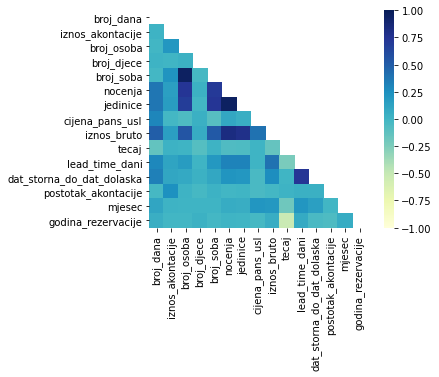

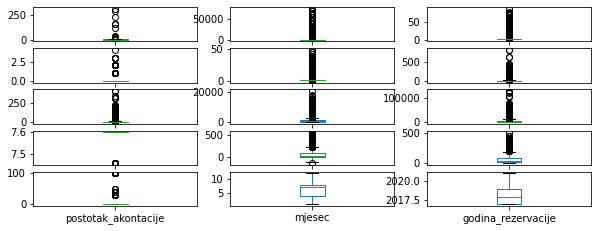

In [8]:
# MATRICA KORELACIJA REZERVACIJE
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
corr_matrix = dfrezervacije.corr()
corr_matrix.to_excel('Matrica_korelacija_rezervacije.xlsx')
print(corr_matrix)
matrix = np.triu(corr_matrix.corr())
sns.heatmap(corr_matrix, fmt='.1g', vmin=-1, vmax=1, center= 0, square=True, mask=matrix, cmap="YlGnBu")
# CMAP VRIJEDNOSTI "YlGnBu"  , "Greens", "Blues"
# box and whisker plots
dfrezervacije.plot(kind='box', subplots=True, layout=(20,3), sharex=False, sharey=False, figsize=(10,15))
plt.show()

In [40]:
dfrezervacije = dfrezervacije.drop(columns=['iznos_bruto', 'jedinice' , 'nocenja', 'broj_osoba', 'lead_time_dani'], axis='columns')
dfrezervacije.shape

(25067, 28)

In [10]:
dfprognoze = dfprognoze.drop(columns=['rosa_prosjek', 'dubina_snijega', 'vidljivost'], axis='columns')
dfprognoze.shape

(17473, 15)

temp_prosjek  temp_max  temp_min  \
temp_prosjek                1.000000  0.975450  0.970909   
temp_max                    0.975450  1.000000  0.907089   
temp_min                    0.970909  0.907089  1.000000   
smjer_vjetra_stupnjevi      0.192925  0.236367  0.127669   
brzina_vjetra              -0.153610 -0.200351 -0.134679   
nalet_vjetra_brzina         0.051174  0.041124  0.057902   
relativna_vlaznost         -0.203412 -0.275063 -0.094349   
tlak_zraka                 -0.239794 -0.169632 -0.317015   
oblaci_pokrice             -0.224823 -0.373190 -0.059890   
oborine_akumulirano        -0.059299 -0.123096  0.008545   
preostalo_dana              0.010080  0.012034  0.011893   

                        smjer_vjetra_stupnjevi  brzina_vjetra  \
temp_prosjek                          0.192925      -0.153610   
temp_max                              0.236367      -0.200351   
temp_min                              0.127669      -0.134679   
smjer_vjetra_stupnjevi                1.000

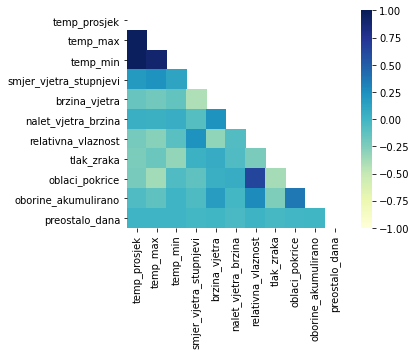

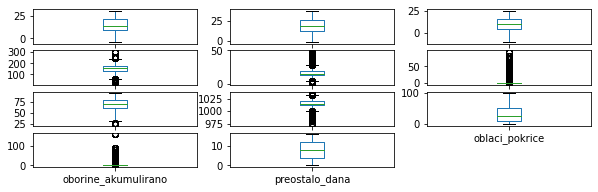

In [11]:
# NOVA MATRICA KORELACIJA PROGNOZE
corr_matrix = dfprognoze.corr()
corr_matrix.to_excel('Matrica_korelacija_prognoze.xlsx')
print(corr_matrix)
matrix = np.triu(corr_matrix.corr())
sns.heatmap(corr_matrix, fmt='.1g', vmin=-1, vmax=1, center= 0, square=True, mask=matrix, cmap="YlGnBu")
# CMAP VRIJEDNOSTI "YlGnBu"  , "Greens", "Blues"
# box and whisker plots
dfprognoze.plot(kind='box', subplots=True, layout=(20,3), sharex=False, sharey=False, figsize=(10,15))
plt.show()

broj_dana  iznos_akontacije  broj_osoba  \
broj_dana                   1.000000          0.018970   -0.004145   
iznos_akontacije            0.018970          1.000000    0.205569   
broj_osoba                 -0.004145          0.205569    1.000000   
broj_djece                  0.020487          0.005251    0.031561   
broj_soba                  -0.009589          0.228586    0.955906   
nocenja                     0.376068          0.153852    0.736810   
jedinice                    0.378363          0.170827    0.690477   
cijena_pans_usl             0.298907         -0.011987   -0.051691   
iznos_bruto                 0.493913          0.149892    0.547288   
tecaj                      -0.133031          0.029027    0.011337   
lead_time_dani              0.293239          0.121467    0.175676   
dat_storna_do_dat_dolaska   0.330521          0.104607    0.089864   
postotak_akontacije        -0.022554          0.242213    0.020688   
mjesec                      0.111330          0

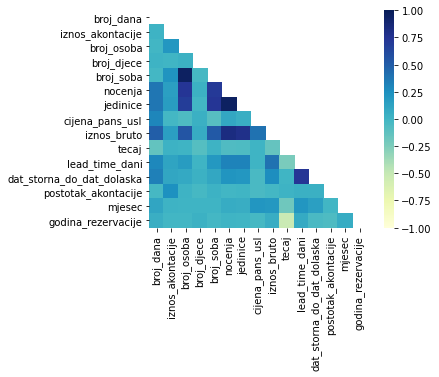

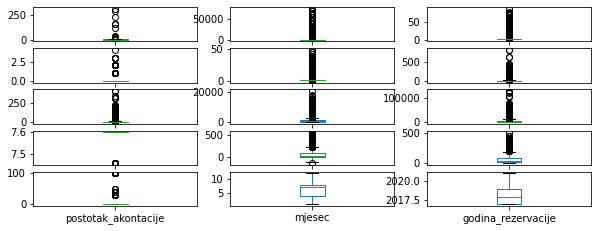

In [12]:
# NOVA MATRICA KORELACIJA REZERVACIJE
corr_matrix = dfrezervacije.corr()
corr_matrix.to_excel('Matrica_korelacija_rezervacije.xlsx')
print(corr_matrix)
matrix = np.triu(corr_matrix.corr())
sns.heatmap(corr_matrix, fmt='.1g', vmin=-1, vmax=1, center= 0, square=True, mask=matrix, cmap="YlGnBu")
# CMAP VRIJEDNOSTI "YlGnBu"  , "Greens", "Blues"
# box and whisker plots
dfrezervacije.plot(kind='box', subplots=True, layout=(20,3), sharex=False, sharey=False, figsize=(10,15))
plt.show()

In [13]:
from PreprocessingListe_final import *
df = ucitaj_podatke_i_spoji_u_jedinstven_set()
df.head()

id                     0
id_rezervacije         0
sif_hotela             0
godina                 0
sif_rezervacije        0
                      ..
temp_min7              0
oborine_mogucnost7     0
brzina_vjetra7         0
index_vrucine7        26
prognoza7              0
Length: 67, dtype: int64


,id,id_rezervacije,sif_hotela,godina,sif_rezervacije,rbr_stavke,vrijeme_kreiranje,datum_kreiranja,broj_dana,sif_usluge,...,p_temp_min_31,p_temp_min_73,p_temp_max_31,p_temp_max_73,p_oborine_mogucnost31,p_oborine_mogucnost73,p_oblaci_pokrice_31,p_oblaci_pokrice_73,p_brzina_vjetra_31,p_brzina_vjetra_73
0,0147c3b4-3153-428f-82c9-e45a675f37e2,5ceca9ed-a582-4e36-bcb3-c725e79e58e9,28,2016,4793,1,15:08:03,2016-10-31,10,PLO,...,-2.5,11.5,-3.3,12.1,0.0,0.0,17.5,-29.5,2.1,1.4
1,2a3c24df-4924-447a-9713-02a789f32779,b134acb1-6490-4914-b535-ab82795ba568,28,2017,3705,1,15:08:03,2017-07-09,7,NDO,...,-5.6,12.8,-12.5,20.0,0.1,-0.1,29.7,-36.6,3.5,-1.8
2,c6d6dfb3-49ff-4c52-8a90-f731d843744c,7e88ea2a-a171-46ae-99b3-3fab9be8f57d,28,2017,4548,1,04:08:03,2017-09-08,4,NDO,...,-3.0,1.5,-0.8,0.5,0.0,0.0,-28.9,4.7,1.4,0.1
3,163e8ad7-d3aa-4b41-8648-ada9fa99313f,4f36e74b-aca2-42ef-91a8-b9ca29b6cefb,28,2017,4548,2,05:08:03,2017-09-08,4,NDO,...,-3.0,1.5,-0.8,0.5,0.0,0.0,-28.9,4.7,1.4,0.1
4,e80fe92c-286c-42de-ba85-8ea190cbfe4b,65923ef5-7051-406e-aa85-017997817308,28,2016,4640,1,23:08:03,2016-10-17,7,PLO,...,7.1,-7.6,13.0,-11.9,-0.1,0.0,-25.0,29.4,-3.4,-4.2


In [14]:
df.columns
df = df.drop(columns=['id', 'id_rezervacije', 'sif_hotela', 'godina', 'sif_rezervacije',
       'rbr_stavke', 'vrijeme_kreiranje', 'datum_kreiranja', 'sif_usluge', 'datum_do_potvrde_opcije', 'sif_drzave', 'sif_agencije', 'tip_ro', 'obaveza_akontacije','vrijeme_storna', 'datum_storna','broj_osoba', 'broj_djece','nocenja', 'jedinice',
       'cijena_pans_usl','valuta', 'tecaj', 'lead_time_dani',
       'dat_storna_do_dat_dolaska','postotak_akontacije','vrsta_sobe_naplata', 'godina_rezervacije'])

In [15]:
df.describe()

,broj_dana,iznos_akontacije,storno,broj_soba,iznos_bruto,mjesec,tlak_zraka1,oblaci_pokrice1,temp_prosjek1,temp_max1,...,p_temp_min_31,p_temp_min_73,p_temp_max_31,p_temp_max_73,p_oborine_mogucnost31,p_oborine_mogucnost73,p_oblaci_pokrice_31,p_oblaci_pokrice_73,p_brzina_vjetra_31,p_brzina_vjetra_73
count,68568.000000,3727.000000,68568.000000,68568.000000,68568.000000,68568.000000,68568.000000,68429.000000,68568.000000,68568.000000,...,68568.000000,68568.000000,68568.000000,68568.000000,68568.000000,68568.000000,68352.000000,68297.000000,68568.000000,68568.000000
mean,10.319114,8568.954446,0.106347,1.194362,815.620093,6.387819,1015.354450,27.287599,18.331166,23.488145,...,0.042682,-0.154703,0.020275,-0.252462,0.061340,0.019355,0.250345,0.447147,-0.096000,0.019933
std,31.953960,10726.787958,0.308283,1.789426,758.848272,2.522416,5.693354,23.141738,6.994419,7.527480,...,3.363643,3.879585,3.652342,4.251242,14.611486,14.745662,22.292330,22.343212,6.270423,6.236165
min,1.000000,60.000000,0.000000,0.000000,0.000000,1.000000,991.600000,0.000000,-3.900000,-1.100000,...,-30.900000,-27.800000,-37.000000,-31.300000,-160.000000,-160.000000,-95.700000,-98.000000,-33.200000,-37.792740
25%,3.000000,1874.050000,0.000000,1.000000,443.940000,5.000000,1012.200000,9.800000,13.600000,18.200000,...,-1.500000,-1.500000,-1.400000,-1.500000,0.000000,0.000000,-10.300000,-10.200000,-2.800000,-2.800000
50%,6.000000,4481.090000,0.000000,1.000000,728.068182,7.000000,1015.000000,20.000000,20.300000,25.500000,...,0.000000,0.000000,-0.100000,-0.200000,0.000000,0.000000,0.700000,0.600000,0.000000,0.000000
75%,8.000000,10995.270000,0.000000,1.000000,1020.010000,8.000000,1018.400000,39.800000,23.800000,29.300000,...,1.500000,1.500000,1.200000,1.200000,0.200000,0.200000,11.500000,11.600000,2.800000,2.900000
max,317.000000,73968.920000,1.000000,49.000000,25202.360000,12.000000,1036.400000,100.000000,30.100000,37.300000,...,28.600000,27.800000,35.400000,28.500000,160.000000,160.000000,100.000000,96.800000,34.000000,34.300000


In [16]:
df.isna().sum()

broj_dana                    0
status_rezervacije           0
iznos_akontacije         64841
storno                       0
broj_soba                    0
iznos_bruto                  0
tip_garancije                0
mjesec                       0
vrsta_sobe                   0
kanal                        0
nacin_rezervacije            0
dan_boravka                  0
tlak_zraka1                  0
oblaci_pokrice1            139
temp_prosjek1                0
temp_max1                    0
temp_min1                    0
oborine_mogucnost1           0
brzina_vjetra1               0
index_vrucine1             168
prognoza1                    0
tlak_zraka3                  0
oblaci_pokrice3            184
temp_prosjek3                0
temp_max3                    0
temp_min3                    0
oborine_mogucnost3           0
brzina_vjetra3               0
index_vrucine3             202
prognoza3                    0
tlak_zraka7                  0
oblaci_pokrice7            194
temp_pro

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 68568 entries, 0 to 68567
Data columns (total 51 columns):
 #   Column                 Non-Null Count  Dtype  
---  ------                 --------------  -----  
 0   broj_dana              68568 non-null  int64  
 1   status_rezervacije     68568 non-null  object 
 2   iznos_akontacije       3727 non-null   float64
 3   storno                 68568 non-null  int64  
 4   broj_soba              68568 non-null  int64  
 5   iznos_bruto            68568 non-null  float64
 6   tip_garancije          68568 non-null  object 
 7   mjesec                 68568 non-null  int64  
 8   vrsta_sobe             68568 non-null  object 
 9   kanal                  68568 non-null  object 
 10  nacin_rezervacije      68568 non-null  object 
 11  dan_boravka            68568 non-null  object 
 12  tlak_zraka1            68568 non-null  float64
 13  oblaci_pokrice1        68429 non-null  float64
 14  temp_prosjek1          68568 non-null  float64
 15  te

In [18]:
df.shape

(68568, 51)

In [19]:
df.columns

Index(['broj_dana', 'status_rezervacije', 'iznos_akontacije', 'storno',
       'broj_soba', 'iznos_bruto', 'tip_garancije', 'mjesec', 'vrsta_sobe',
       'kanal', 'nacin_rezervacije', 'dan_boravka', 'tlak_zraka1',
       'oblaci_pokrice1', 'temp_prosjek1', 'temp_max1', 'temp_min1',
       'oborine_mogucnost1', 'brzina_vjetra1', 'index_vrucine1', 'prognoza1',
       'tlak_zraka3', 'oblaci_pokrice3', 'temp_prosjek3', 'temp_max3',
       'temp_min3', 'oborine_mogucnost3', 'brzina_vjetra3', 'index_vrucine3',
       'prognoza3', 'tlak_zraka7', 'oblaci_pokrice7', 'temp_prosjek7',
       'temp_max7', 'temp_min7', 'oborine_mogucnost7', 'brzina_vjetra7',
       'index_vrucine7', 'prognoza7', 'p_tlak_zraka_31', 'p_tlak_zraka_73',
       'p_temp_min_31', 'p_temp_min_73', 'p_temp_max_31', 'p_temp_max_73',
       'p_oborine_mogucnost31', 'p_oborine_mogucnost73', 'p_oblaci_pokrice_31',
       'p_oblaci_pokrice_73', 'p_brzina_vjetra_31', 'p_brzina_vjetra_73'],
      dtype='object')

In [20]:
import seaborn as sns
#zamjenske = {'storno': {"DA":1, "NE":0}}
#df.replace(zamjenske, inplace=True)
sns.pairplot(df, vars=['broj_dana', 'iznos_akontacije', 
       'broj_soba', 'iznos_bruto', 'mjesec', 
       'tlak_zraka1',
       'oblaci_pokrice1', 'temp_prosjek1', 'temp_max1', 'temp_min1',
       'oborine_mogucnost1', 'brzina_vjetra1', 'index_vrucine1',
       'tlak_zraka3', 'oblaci_pokrice3', 'temp_prosjek3', 'temp_max3',
       'temp_min3', 'oborine_mogucnost3', 'brzina_vjetra3', 'index_vrucine3',
       'tlak_zraka7', 'oblaci_pokrice7', 'temp_prosjek7',
       'temp_max7', 'temp_min7', 'oborine_mogucnost7', 'brzina_vjetra7',
       'index_vrucine7', 'p_tlak_zraka_31', 'p_tlak_zraka_73',
       'p_temp_min_31', 'p_temp_min_73', 'p_temp_max_31', 'p_temp_max_73',
       'p_oborine_mogucnost31', 'p_oborine_mogucnost73', 'p_oblaci_pokrice_31',
       'p_oblaci_pokrice_73', 'p_brzina_vjetra_31', 'p_brzina_vjetra_73'], hue='storno')
plt.show()

In [21]:
df.head()

,broj_dana,status_rezervacije,iznos_akontacije,storno,broj_soba,iznos_bruto,tip_garancije,mjesec,vrsta_sobe,kanal,...,p_temp_min_31,p_temp_min_73,p_temp_max_31,p_temp_max_73,p_oborine_mogucnost31,p_oborine_mogucnost73,p_oblaci_pokrice_31,p_oblaci_pokrice_73,p_brzina_vjetra_31,p_brzina_vjetra_73
0,10,F,NaN,1,1,663.945000,N,9,B220,B2B,...,-2.5,11.5,-3.3,12.1,0.0,0.0,17.5,-29.5,2.1,1.4
1,7,F,NaN,1,1,266.511429,N,9,D110,B2B,...,-5.6,12.8,-12.5,20.0,0.1,-0.1,29.7,-36.6,3.5,-1.8
2,4,F,NaN,1,1,289.405000,N,9,D110,B2B,...,-3.0,1.5,-0.8,0.5,0.0,0.0,-28.9,4.7,1.4,0.1
3,4,F,NaN,1,1,289.405000,N,9,D110,B2B,...,-3.0,1.5,-0.8,0.5,0.0,0.0,-28.9,4.7,1.4,0.1
4,7,F,NaN,1,1,661.801429,N,9,A2M20,B2B,...,7.1,-7.6,13.0,-11.9,-0.1,0.0,-25.0,29.4,-3.4,-4.2


<Figure size 432x288 with 0 Axes>

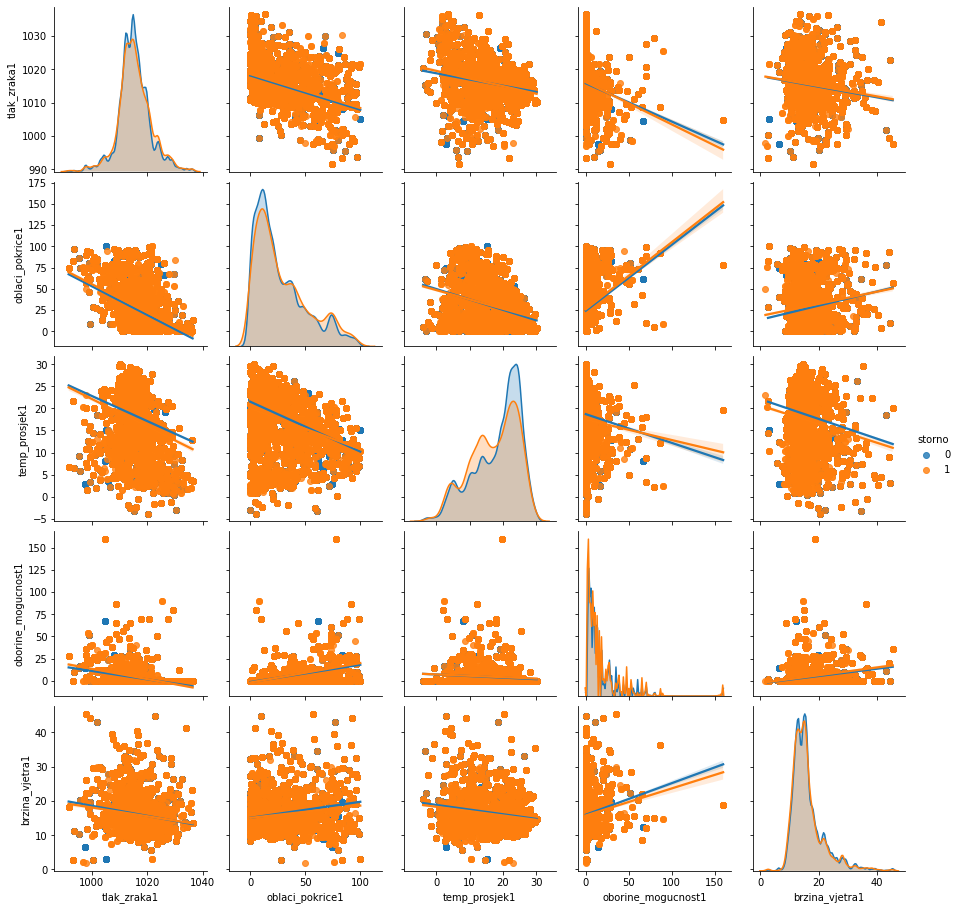

In [30]:
plt.figure()
sns.pairplot(df, vars=['tlak_zraka1','oblaci_pokrice1', 'temp_prosjek1',
       'oborine_mogucnost1', 'brzina_vjetra1'], hue='storno')
plt.savefig('Distribucija vrijednosti pozitivne klase.png')
plt.show()

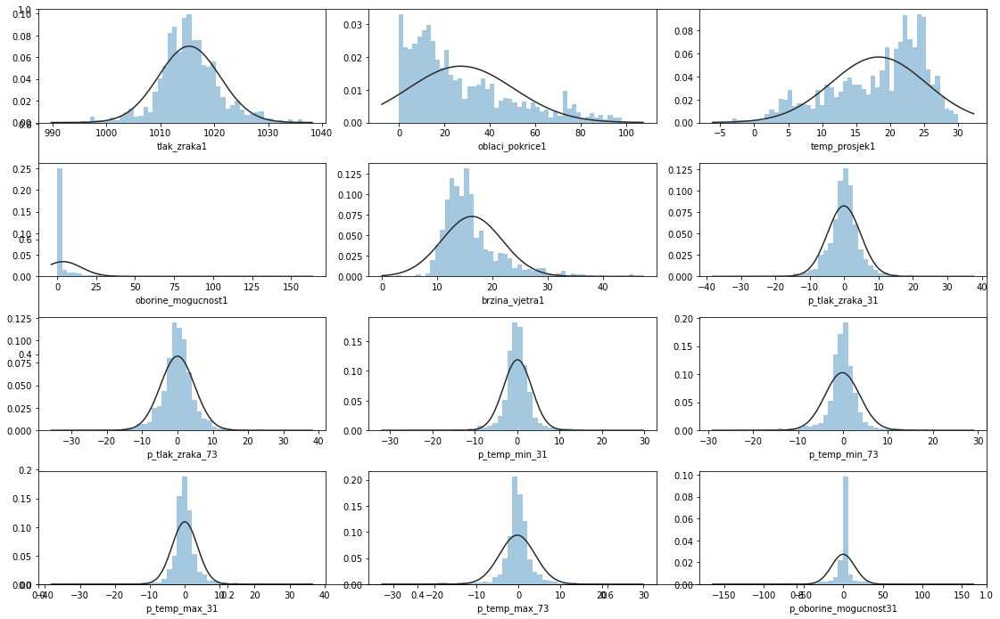

In [37]:
from scipy.stats import norm 
kolone = ['tlak_zraka1','oblaci_pokrice1', 'temp_prosjek1',
       'oborine_mogucnost1', 'brzina_vjetra1', 'p_tlak_zraka_31', 'p_tlak_zraka_73', 'p_temp_min_31', 'p_temp_min_73', 'p_temp_max_31', 'p_temp_max_73',                  'p_oborine_mogucnost31' ]
fig, ax = plt.subplots(figsize = (16, 10)) 
for i, col in enumerate(kolone): 
    ax=fig.add_subplot(4, 3, i+1) 
    sns.distplot(df[col],fit=norm, kde=False,ax=ax) 
    plt.tight_layout()
plt.savefig('Prikaz distribucije vrijednosti ulaznih atributa.png')
plt.show()


Top 95%: 21.5
Top 2%: 22.2
Najniža zabilježena temperatura -10.1
95% storna je kod temp ispod: 21.4


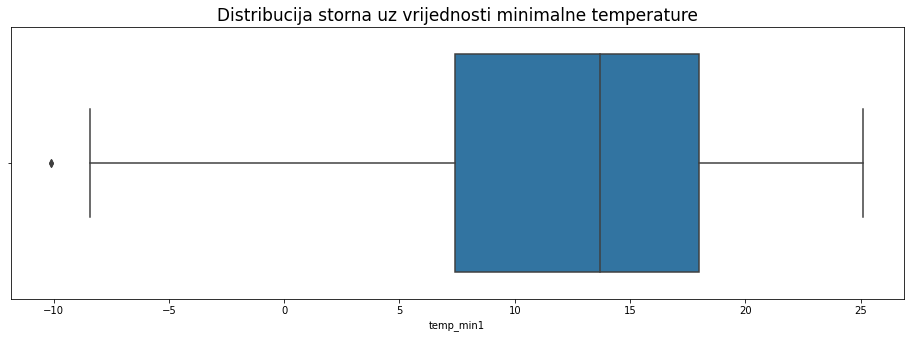

In [38]:
# INFO - TEMP MIN
print('Top 95%:', round(df.temp_min1.quantile(.95),2))
print('Top 2%:', round(df.temp_min1.quantile(.98),2))
print('Najniža zabilježena temperatura', round(df.temp_min1.quantile(0),2))
print('95% storna je kod temp ispod:', round(df.temp_min1[df.storno==1].quantile(.95),2))

# PLOT - STORNO - temp_min
plt.figure(figsize=(16,5))
sns.boxplot(x=df.temp_min1[df.storno == 1])
plt.title('Distribucija storna uz vrijednosti minimalne temperature',fontsize=17)
plt.show()

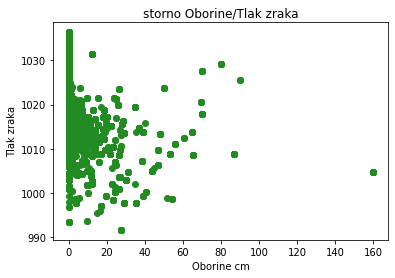

In [44]:
# PLOTANJE GRAFOVA VEZANIH ISKLJUČIVO UZ PODSET GDJE JE STORNO = 1
x = df[df['storno'] == 1]
plt.figure()
plt.scatter(x=x['oborine_mogucnost1'], y=x['tlak_zraka1'], c='forestgreen')
plt.title('storno Oborine/Tlak zraka')
plt.xlabel('Oborine cm') 
plt.ylabel('Tlak zraka')
plt.savefig('Storno Oborine_Tlak_Zraka.png')
plt.show()

In [43]:
df.storno.sum()

7292

In [42]:
lista2 = RezervacijeDani.listaj()
df2 = pd.DataFrame(lista2)
df2 = df2['dat_storna_do_dat_dolaska']
df2.storno.sum()

31011